In [ ]:
import os
import numpy as np 
import pandas as pd 
from skimage.io import imread
import glob
import argparse
import os
import sys
import datetime
import time
import math
import json
from pathlib import Path

import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torch.distributed as dist
import torch.backends.cudnn as cudnn
import torch.nn.functional as F
from torchvision import datasets, transforms
from torchvision import models as torchvision_models

from google.colab import drive
drive.mount('/content/drive/')
#os.chdir('/content/drive/MyDrive/')

import sys 
sys.path.append('/content/drive/MyDrive/DinoFW/dino/')
import utils
import vision_transformer as vits
from vision_transformer import DINOHead

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
#len(os.listdir('predicted_patches/litter/')),len(os.listdir('predicted_patches/no_litter/'))

# DINO architecture initialization

In [ ]:
class DataAugmentationDINO(object):
    def __init__(self, global_crops_scale, local_crops_scale, local_crops_number):
        flip_and_color_jitter = transforms.Compose([
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.RandomApply(
                [transforms.ColorJitter(brightness=0.4, contrast=0.4, saturation=0.2, hue=0.1)],
                p=0.8
            ),
            transforms.RandomGrayscale(p=0.2),
        ])
        normalize = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
        ])

        # first global crop
        self.global_transfo1 = transforms.Compose([
            transforms.RandomResizedCrop(224, scale=global_crops_scale, interpolation=Image.BICUBIC),
            flip_and_color_jitter,
            utils.GaussianBlur(1.0),
            normalize,
        ])
        # second global crop
        self.global_transfo2 = transforms.Compose([
            transforms.RandomResizedCrop(224, scale=global_crops_scale, interpolation=Image.BICUBIC),
            flip_and_color_jitter,
            utils.GaussianBlur(0.1),
            utils.Solarization(0.2),
            normalize,
        ])
        # transformation for the local small crops
        self.local_crops_number = local_crops_number
        self.local_transfo = transforms.Compose([
            transforms.RandomResizedCrop(96, scale=local_crops_scale, interpolation=Image.BICUBIC),
            flip_and_color_jitter,
            utils.GaussianBlur(p=0.5),
            normalize,
        ])

    def __call__(self, image):
        crops = []
        crops.append(self.global_transfo1(image))
        crops.append(self.global_transfo2(image))
        for _ in range(self.local_crops_number):
            crops.append(self.local_transfo(image))
        return crops

In [ ]:
class DINOLoss(nn.Module):
    def __init__(self, out_dim, ncrops, warmup_teacher_temp, teacher_temp,
                 warmup_teacher_temp_epochs, nepochs, student_temp=0.1,
                 center_momentum=0.9):
        super().__init__()
        self.student_temp = student_temp
        self.center_momentum = center_momentum
        self.ncrops = ncrops
        self.register_buffer("center", torch.zeros(1, out_dim))
        # we apply a warm up for the teacher temperature because
        # a too high temperature makes the training instable at the beginning
        self.teacher_temp_schedule = np.concatenate((
            np.linspace(warmup_teacher_temp,
                        teacher_temp, warmup_teacher_temp_epochs),
            np.ones(nepochs - warmup_teacher_temp_epochs) * teacher_temp
        ))

    def forward(self, student_output, teacher_output, epoch):
        """
        Cross-entropy between softmax outputs of the teacher and student networks.
        """
        student_out = student_output / self.student_temp
        student_out = student_out.chunk(self.ncrops)

        # teacher centering and sharpening
        temp = self.teacher_temp_schedule[epoch]
        teacher_out = F.softmax((teacher_output - self.center) / temp, dim=-1)
        teacher_out = teacher_out.detach().chunk(2)

        total_loss = 0
        n_loss_terms = 0
        for iq, q in enumerate(teacher_out):
            for v in range(len(student_out)):
                if v == iq:
                    # we skip cases where student and teacher operate on the same view
                    continue
                loss = torch.sum(-q * F.log_softmax(student_out[v], dim=-1), dim=-1)
                total_loss += loss.mean()
                n_loss_terms += 1
        total_loss /= n_loss_terms
        self.update_center(teacher_output)
        return total_loss
        
    @torch.no_grad()
    def update_center(self, teacher_output):
        """
        Update center used for teacher output.
        """
        batch_center = torch.sum(teacher_output, dim=0, keepdim=True)
        dist.all_reduce(batch_center)
        batch_center = batch_center / (len(teacher_output) * dist.get_world_size())

        # ema update
        self.center = self.center * self.center_momentum + batch_center * (1 - self.center_momentum)



# DINO Training

In [ ]:
def train_dino(args):
    init_distributed_mode(args)
    utils.fix_random_seeds(args['seed'])
    print("git:\n  {}\n".format(utils.get_sha()))
    #print("\n".join("%s: %s" % (k, str(v)) for k, v in sorted(dict(vars(args)).items())))
    cudnn.benchmark = True

    # ============ preparing data ... ============
    transform = DataAugmentationDINO(
        args['global_crops_scale'],
        args['local_crops_scale'],
        args['local_crops_number'],
    )
    dataset = datasets.ImageFolder(args['data_path'], transform=transform)
    sampler = torch.utils.data.DistributedSampler(dataset, shuffle=True)
    data_loader = torch.utils.data.DataLoader(
        dataset,
        sampler=sampler,
        batch_size=args['batch_size_per_gpu'],
        num_workers=args['num_workers'],
        pin_memory=True,
        drop_last=True,
    )
    print(f"Data loaded: there are {len(dataset)} images.")

    # ============ building student and teacher networks ... ============
    # we changed the name DeiT-S for ViT-S to avoid confusions
    args['arch'] = args['arch'].replace("deit", "vit")
    # if the network is a Vision Transformer (i.e. vit_tiny, vit_small, vit_base)
    if args['arch'] in vits.__dict__.keys():
        student = vits.__dict__[args['arch']](
            patch_size=args['patch_size'],
            drop_path_rate=args['drop_path_rate'],  # stochastic depth
        )
        teacher = vits.__dict__[args['arch']](patch_size=args['patch_size'])
        embed_dim = student.embed_dim
    # if the network is a XCiT
    elif args['arch'] in torch.hub.list("facebookresearch/xcit:main"):
        student = torch.hub.load('facebookresearch/xcit:main', args['arch'],
                                 pretrained=False, drop_path_rate=args['drop_path_rate'])
        teacher = torch.hub.load('facebookresearch/xcit:main', args['arch'], pretrained=False)
        embed_dim = student.embed_dim
    # otherwise, we check if the architecture is in torchvision models
    elif args['arch'] in torchvision_models.__dict__.keys():
        student = torchvision_models.__dict__[args['arch']]()
        teacher = torchvision_models.__dict__[args['arch']]()
        embed_dim = student.fc.weight.shape[1]
    else:
        print(f"Unknow architecture: {args['arch']}")

    # multi-crop wrapper handles forward with inputs of different resolutions
    student = utils.MultiCropWrapper(student, DINOHead(
        embed_dim,
        args['out_dim'],
        use_bn=args['use_bn_in_head'],
        norm_last_layer=args['norm_last_layer'],
    ))
    teacher = utils.MultiCropWrapper(
        teacher,
        DINOHead(embed_dim, args['out_dim'], args['use_bn_in_head']),
    )
    # move networks to gpu
    student, teacher = student.cuda(), teacher.cuda()
    # synchronize batch norms (if any)
    if utils.has_batchnorms(student):
        student = nn.SyncBatchNorm.convert_sync_batchnorm(student)
        teacher = nn.SyncBatchNorm.convert_sync_batchnorm(teacher)

        # we need DDP wrapper to have synchro batch norms working...
        teacher = nn.parallel.DistributedDataParallel(teacher, device_ids=[args['gpu']])
        teacher_without_ddp = teacher.module
    else:
        # teacher_without_ddp and teacher are the same thing
        teacher_without_ddp = teacher
    student = nn.parallel.DistributedDataParallel(student, device_ids=[args['gpu']])
    # teacher and student start with the same weights
    teacher_without_ddp.load_state_dict(student.module.state_dict())
    # there is no backpropagation through the teacher, so no need for gradients
    for p in teacher.parameters():
        p.requires_grad = False
    print(f"Student and Teacher are built: they are both {args['arch']} network.")

    # ============ preparing loss ... ============
    dino_loss = DINOLoss(
        args['out_dim'],
        args['local_crops_number'] + 2,  # total number of crops = 2 global crops + local_crops_number
        args['warmup_teacher_temp'],
        args['teacher_temp'],
        args['warmup_teacher_temp_epochs'],
        args['epochs'],
    ).cuda()

    # ============ preparing optimizer ... ============
    params_groups = utils.get_params_groups(student)
    if args['optimizer'] == "adamw":
        optimizer = torch.optim.AdamW(params_groups)  # to use with ViTs
    elif args['optimizer'] == "sgd":
        optimizer = torch.optim.SGD(params_groups, lr=0, momentum=0.9)  # lr is set by scheduler
    elif args['optimizer'] == "lars":
        optimizer = utils.LARS(params_groups)  # to use with convnet and large batches
    # for mixed precision training
    fp16_scaler = None
    if args['use_fp16']:
        fp16_scaler = torch.cuda.amp.GradScaler()

    # ============ init schedulers ... ============
    lr_schedule = utils.cosine_scheduler(
        args['lr'] * (args['batch_size_per_gpu'] * utils.get_world_size()) / 256.,  # linear scaling rule
        args['min_lr'],
        args['epochs'], len(data_loader),
        warmup_epochs=args['warmup_epochs'],
    )
    wd_schedule = utils.cosine_scheduler(
        args['weight_decay'],
        args['weight_decay_end'],
        args['epochs'], len(data_loader),
    )
    # momentum parameter is increased to 1. during training with a cosine schedule
    momentum_schedule = utils.cosine_scheduler(args['momentum_teacher'], 1,
                                               args['epochs'], len(data_loader))
    print(f"Loss, optimizer and schedulers ready.")

    # ============ optionally resume training ... ============
    to_restore = {"epoch": 0}
    utils.restart_from_checkpoint(
        os.path.join(args['output_dir'], "checkpoint.pth"),
        run_variables=to_restore,
        student=student,
        teacher=teacher,
        optimizer=optimizer,
        fp16_scaler=fp16_scaler,
        dino_loss=dino_loss,
    )
    start_epoch = to_restore["epoch"]

    start_time = time.time()
    print("Starting DINO training !")
    for epoch in range(start_epoch, args['epochs']):
        data_loader.sampler.set_epoch(epoch)

        # ============ training one epoch of DINO ... ============
        train_stats = train_one_epoch(student, teacher, teacher_without_ddp, dino_loss,
            data_loader, optimizer, lr_schedule, wd_schedule, momentum_schedule,
            epoch, fp16_scaler, args)

        # ============ writing logs ... ============
        save_dict = {
            'student': student.state_dict(),
            'teacher': teacher.state_dict(),
            'optimizer': optimizer.state_dict(),
            'epoch': epoch + 1,
            'args': args,
            'dino_loss': dino_loss.state_dict(),
        }
        if fp16_scaler is not None:
            save_dict['fp16_scaler'] = fp16_scaler.state_dict()
        utils.save_on_master(save_dict, os.path.join(args['output_dir'], 'checkpoint.pth'))
        if args['saveckp_freq'] and epoch % args['saveckp_freq'] == 0:
            utils.save_on_master(save_dict, os.path.join(args['output_dir'], f'checkpoint{epoch:04}.pth'))
        log_stats = {**{f'train_{k}': v for k, v in train_stats.items()},
                     'epoch': epoch}
        if utils.is_main_process():
            with (Path(args['output_dir']) / "log.txt").open("a") as f:
                f.write(json.dumps(log_stats) + "\n")
    total_time = time.time() - start_time
    total_time_str = str(datetime.timedelta(seconds=int(total_time)))
    print('Training time {}'.format(total_time_str))


def train_one_epoch(student, teacher, teacher_without_ddp, dino_loss, data_loader,
                    optimizer, lr_schedule, wd_schedule, momentum_schedule,epoch,
                    fp16_scaler, args):
    metric_logger = utils.MetricLogger(delimiter="  ")
    header = 'Epoch: [{}/{}]'.format(epoch, args['epochs'])
    for it, (images, _) in enumerate(metric_logger.log_every(data_loader, 10, header)):
        # update weight decay and learning rate according to their schedule
        it = len(data_loader) * epoch + it  # global training iteration
        for i, param_group in enumerate(optimizer.param_groups):
            param_group["lr"] = lr_schedule[it]
            if i == 0:  # only the first group is regularized
                param_group["weight_decay"] = wd_schedule[it]

        # move images to gpu
        images = [im.cuda(non_blocking=True) for im in images]
        # teacher and student forward passes + compute dino loss
        with torch.cuda.amp.autocast(fp16_scaler is not None):
            teacher_output = teacher(images[:2])  # only the 2 global views pass through the teacher
            student_output = student(images)
            loss = dino_loss(student_output, teacher_output, epoch)

        if not math.isfinite(loss.item()):
            print("Loss is {}, stopping training".format(loss.item()), force=True)
            sys.exit(1)

        # student update
        optimizer.zero_grad()
        param_norms = None
        if fp16_scaler is None:
            loss.backward()
            if args['clip_grad']:
                param_norms = utils.clip_gradients(student, args['clip_grad'])
            utils.cancel_gradients_last_layer(epoch, student,
                                              args['freeze_last_layer'])
            optimizer.step()
        else:
            fp16_scaler.scale(loss).backward()
            if args['clip_grad']:
                fp16_scaler.unscale_(optimizer)  # unscale the gradients of optimizer's assigned params in-place
                param_norms = utils.clip_gradients(student, args['clip_grad'])
            utils.cancel_gradients_last_layer(epoch, student,
                                              args['freeze_last_layer'])
            fp16_scaler.step(optimizer)
            fp16_scaler.update()

        # EMA update for the teacher
        with torch.no_grad():
            m = momentum_schedule[it]  # momentum parameter
            for param_q, param_k in zip(student.module.parameters(), teacher_without_ddp.parameters()):
                param_k.data.mul_(m).add_((1 - m) * param_q.detach().data)

        # logging
        torch.cuda.synchronize()
        metric_logger.update(loss=loss.item())
        metric_logger.update(lr=optimizer.param_groups[0]["lr"])
        metric_logger.update(wd=optimizer.param_groups[0]["weight_decay"])
    # gather the stats from all processes
    metric_logger.synchronize_between_processes()
    print("Averaged stats:", metric_logger)
    return {k: meter.global_avg for k, meter in metric_logger.meters.items()}



    @torch.no_grad()
    def update_center(self, teacher_output):
        """
        Update center used for teacher output.
        """
        batch_center = torch.sum(teacher_output, dim=0, keepdim=True)
        dist.all_reduce(batch_center)
        batch_center = batch_center / (len(teacher_output) * dist.get_world_size())

        # ema update
        self.center = self.center * self.center_momentum + batch_center * (1 - self.center_momentum)



In [ ]:
def init_distributed_mode(args):
    # launched with torch.distributed.launch
    if 'RANK' in os.environ and 'WORLD_SIZE' in os.environ:
        args['rank'] = int(os.environ["RANK"])
        args['world_size'] = int(os.environ['WORLD_SIZE'])
        args['gpu'] = int(os.environ['LOCAL_RANK'])
    # launched with submitit on a slurm cluster
    elif 'SLURM_PROCID' in os.environ:
        args['rank'] = int(os.environ['SLURM_PROCID'])
        args['gpu'] = args['rank'] % torch.cuda.device_count()
    # launched naively with `python main_dino.py`
    # we manually add MASTER_ADDR and MASTER_PORT to env variables
    elif torch.cuda.is_available():
        print('Will run the code on one GPU.')
        args['rank'], args['gpu'], args['world_size'] = 0, 0, 1
        os.environ['MASTER_ADDR'] = '127.0.0.1'
        os.environ['MASTER_PORT'] = '29500'
    else:
        print('Does not support training without GPU.')
        sys.exit(1)

    dist.init_process_group(
        backend="nccl",
        init_method=args['dist_url'],
        world_size=args['world_size'],
        rank=args['rank'],
    )

    torch.cuda.set_device(args['gpu'])
    print('| distributed init (rank {}): {}'.format(
        args['rank'], args['dist_url']), flush=True)
    dist.barrier()
    setup_for_distributed(args['rank'] == 0)
    
def setup_for_distributed(is_master):
    """
    This function disables printing when not in master process
    """
    import builtins as __builtin__
    builtin_print = __builtin__.print

    def print(*args, **kwargs):
        force = kwargs.pop('force', False)
        if is_master or force:
            builtin_print(*args, **kwargs)

    __builtin__.print = print

In [ ]:
#import shutil
#shutil.copy('/root/.cache/torch/hub/checkpoints/dino_deitsmall16_pretrain.pth', '/content/drive/MyDrive/output_dino/pretrained/dino_deitsmall16_pretrain.pth')

In [ ]:
#vits16 = torch.hub.load('facebookresearch/dino:main', 'dino_vits16')

In [ ]:
# Model parameters
d = {'arch' : 'vit_tiny',  #['vit_tiny', 'vit_small', 'vit_base', 'xcit', 'deit_tiny', 'deit_small'] \ 
  'patch_size': 16, 
  'out_dim':65536,
  'norm_last_layer':True,
  'momentum_teacher':0.996,
  'use_bn_in_head': False,

  # Temperature teacher parameters
  'warmup_teacher_temp':0.04,
  'teacher_temp':0.04,
  'warmup_teacher_temp_epochs':0,

  # Training/Optimization parameters
  'use_fp16':True,
  'weight_decay':0.04,
  'weight_decay_end':0.4,
  'clip_grad':3.0,
  'batch_size_per_gpu':8, ####
  'epochs':100,
  'freeze_last_layer':1,
  'lr':0.0005,
  'warmup_epochs':10,
  'min_lr':1e-6,
  'optimizer':'adamw', #choices=['adamw', 'sgd', 'lars'], help="""Type of optimizer. We recommend using adamw with ViTs.""")
  'drop_path_rate':0.1,

  # Multi-crop parameters
  'global_crops_scale':(0.4, 1.),
  'local_crops_number':8,
  'local_crops_scale':(0.05, 0.4),

  # Data
  'data_path':'/content/drive/MyDrive/predicted_patches/training_and_unlabeled/',
  'output_dir':'/content/drive/MyDrive/output_dino/on_training_and_pseudolabeled/',
  'saveckp_freq':10,
  'seed':0,
  'num_workers':10,
  'dist_url': 'env://',
  'local_rank':0 }

In [ ]:
train_dino(d)

Will run the code on one GPU.
| distributed init (rank 0): env://
git:
  sha: cb711401860da580817918b9167ed73e3eef3dcf, status: has uncommited changes, branch: main



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:892: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  "Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. "
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 10 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Data loaded: there are 2014 images.
Student and Teacher are built: they are both vit_tiny network.
Loss, optimizer and schedulers ready.
Starting DINO training !
Epoch: [0/100]  [  0/251]  eta: 0:55:48  loss: 10.825862 (10.825862)  lr: 0.000000 (0.000000)  wd: 0.040000 (0.040000)  time: 13.338767  data: 3.251897  max mem: 1146
Epoch: [0/100]  [ 10/251]  eta: 0:06:02  loss: 10.891301 (10.875977)  lr: 0.000000 (0.000000)  wd: 0.040000 (0.040000)  time: 1.504191  data: 0.296974  max mem: 1253
Epoch: [0/100]  [ 20/251]  eta: 0:03:41  loss: 10.890194 (10.871344)  lr: 0.000000 (0.000000)  wd: 0.040000 (0.040000)  time: 0.339929  data: 0.000979  max mem: 1253
Epoch: [0/100]  [ 30/251]  eta: 0:02:48  loss: 10.890194 (10.889891)  lr: 0.000000 (0.000000)  wd: 0.040001 (0.040000)  time: 0.352136  data: 0.000707  max mem: 1253
Epoch: [0/100]  [ 40/251]  eta: 0:02:19  loss: 10.966206 (10.923917)  lr: 0.000000 (0.000000)  wd: 0.040001 (0.040001)  time: 0.350886  data: 0.001219  max mem: 1253
Epoch: 

In [ ]:
!pip install timm

# Classification Evaluation with KNN and Logistic Regression

### Dataset folders preparation

In [ ]:
import shutil 

def prepare_dataset_folders(df, dataset_path, patches_rootdir):
  if not os.path.exists(os.path.join(dataset_path, 'litter')):
    os.mkdir(os.path.join(dataset_path, 'litter'))
    os.mkdir(os.path.join(dataset_path, 'no_litter'))
  for i in range(len(df)):
    row = df.loc[i, :]
    patch_filename = os.path.join(patches_rootdir, os.path.basename(row['patch_filename']))
    if row['plastic'] == 1:
      patch_dest = os.path.join(os.path.join(dataset_path, 'litter/'), os.path.basename(row['patch_filename']))
      shutil.copy(patch_filename, patch_dest)
    elif row['plastic'] == 0:
      patch_dest = os.path.join(os.path.join(dataset_path, 'no_litter/'), os.path.basename(row['patch_filename']))
      shutil.copy(patch_filename, patch_dest)
    else:
      print("patch unlabeled: {}, {}".format(os.path.basename(row['patch_filename']), row['plastic']))

In [ ]:
# PREPARE TEST AND TRAINING FOLDERS
import pandas as pd 

patches_rootdir='/content/drive/MyDrive/root_patches/patches/'

df_unlab = pd.read_csv('/content/drive/MyDrive/unlabeled.csv')
training_set = pd.read_csv('/content/drive/MyDrive/training_set.csv')
test_set = pd.read_csv('/content/drive/MyDrive/test_set.csv')
validation_set = pd.read_csv('/content/drive/MyDrive/validation_set.csv')

training_set = pd.concat([training_set, validation_set], ignore_index=True)

train_path = '/content/drive/MyDrive/datasets_knn/train/'
#val_path = '/content/drive/MyDrive/datasets_knn/val/'
test_path = '/content/drive/MyDrive/datasets_knn/test/'

if not os.path.exists('/content/drive/MyDrive/datasets_knn/'):
  os.makedirs(train_path)
  #os.makedirs(val_path)
  os.makedirs(test_path)

prepare_dataset_folders(training_set, train_path, patches_rootdir)
#prepare_dataset_folders(validation_set, val_path, patches_rootdir)
prepare_dataset_folders(test_set, test_path, patches_rootdir)

## Adaptation of KNN evaluation

In [ ]:
# Copyright (c) Facebook, Inc. and its affiliates.
# 
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
# 
#     http://www.apache.org/licenses/LICENSE-2.0
# 
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
import os
import sys
import argparse

import torch
from torch import nn
import torch.distributed as dist
import torch.backends.cudnn as cudnn
from torchvision import datasets
from torchvision import transforms as pth_transforms
from torchvision import models as torchvision_models
from sklearn.neighbors import KNeighborsClassifier

import utils
import vision_transformer as vits


def extract_feature_pipeline(args):
    # ============ preparing data ... ============
    transform = pth_transforms.Compose([
        pth_transforms.Resize(256, interpolation=3),
        pth_transforms.CenterCrop(224),
        pth_transforms.ToTensor(),
        pth_transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
    ])
    dataset_train = ReturnIndexDataset(os.path.join(args["data_path"], "train"), transform=transform)
    dataset_val = ReturnIndexDataset(os.path.join(args["data_path"], "val"), transform=transform)
    sampler = torch.utils.data.DistributedSampler(dataset_train, shuffle=False)
    data_loader_train = torch.utils.data.DataLoader(
        dataset_train,
        sampler=sampler,
        batch_size=args["batch_size_per_gpu"],
        num_workers=args["num_workers"],
        pin_memory=True,
        drop_last=False,
    )
    data_loader_val = torch.utils.data.DataLoader(
        dataset_val,
        batch_size=args["batch_size_per_gpu"],
        num_workers=args["num_workers"],
        pin_memory=True,
        drop_last=False,
    )
    print(f"Data loaded with {len(dataset_train)} train and {len(dataset_val)} val imgs.")

    # ============ building network ... ============
    if "vit" in args['arch']:
        model = vits.__dict__[args["arch"]](patch_size=args["patch_size"], num_classes=0)
        #print(f"Model {args["arch"]} {args["patch_size"]}x{args["patch_size"]} built.")
    elif "xcit" in args['arch']:
        model = torch.hub.load('facebookresearch/xcit:main', args.arch, num_classes=0)
    elif args['arch'] in torchvision_models.__dict__.keys():
        model = torchvision_models.__dict__[args["arch"]](num_classes=0)
        model.fc = nn.Identity()
    else:
        #print(f"Architecture {args["arch"]} non supported")
        sys.exit(1)
    model.cuda()
    utils.load_pretrained_weights(model, args["pretrained_weights"], args["checkpoint_key"], args["arch"], args["patch_size"])
    model.eval()

    # ============ extract features ... ============
    print("Extracting features for train set...")
    train_features = extract_features(model, data_loader_train, args["use_cuda"])
    print("Extracting features for val set...")
    test_features = extract_features(model, data_loader_val, args["use_cuda"])

    if utils.get_rank() == 0:
        train_features = nn.functional.normalize(train_features, dim=1, p=2)
        test_features = nn.functional.normalize(test_features, dim=1, p=2)

    train_labels = torch.tensor([s[-1] for s in dataset_train.samples]).long()
    test_labels = torch.tensor([s[-1] for s in dataset_val.samples]).long()
    # save features and labels
    if args['dump_features'] and dist.get_rank() == 0:
        torch.save(train_features.cpu(), os.path.join(args["dump_features"], "trainfeat.pth"))
        torch.save(test_features.cpu(), os.path.join(args["dump_features"], "testfeat.pth"))
        torch.save(train_labels.cpu(), os.path.join(args["dump_features"], "trainlabels.pth"))
        torch.save(test_labels.cpu(), os.path.join(args["dump_features"], "testlabels.pth"))
    return train_features, test_features, train_labels, test_labels


@torch.no_grad()
def extract_features(model, data_loader, use_cuda=True, multiscale=False):
    metric_logger = utils.MetricLogger(delimiter="  ")
    features = None
    for samples, index in metric_logger.log_every(data_loader, 10):
        samples = samples.cuda(non_blocking=True)
        index = index.cuda(non_blocking=True)
        if multiscale:
            feats = utils.multi_scale(samples, model)
        else:
            feats = model(samples).clone()

        # init storage feature matrix
        if dist.get_rank() == 0 and features is None:
            features = torch.zeros(len(data_loader.dataset), feats.shape[-1])
            if use_cuda:
                features = features.cuda(non_blocking=True)
            print(f"Storing features into tensor of shape {features.shape}")

        # get indexes from all processes
        y_all = torch.empty(dist.get_world_size(), index.size(0), dtype=index.dtype, device=index.device)
        y_l = list(y_all.unbind(0))
        y_all_reduce = torch.distributed.all_gather(y_l, index, async_op=True)
        y_all_reduce.wait()
        index_all = torch.cat(y_l)

        # share features between processes
        feats_all = torch.empty(
            dist.get_world_size(),
            feats.size(0),
            feats.size(1),
            dtype=feats.dtype,
            device=feats.device,
        )
        output_l = list(feats_all.unbind(0))
        output_all_reduce = torch.distributed.all_gather(output_l, feats, async_op=True)
        output_all_reduce.wait()

        # update storage feature matrix
        if dist.get_rank() == 0:
            if use_cuda:
                features.index_copy_(0, index_all, torch.cat(output_l))
            else:
                features.index_copy_(0, index_all.cpu(), torch.cat(output_l).cpu())
    return features


@torch.no_grad()
def knn_classifier(train_features, train_labels, test_features, test_labels, k, T, num_classes=2):
    top1, top5, total = 0.0, 0.0, 0
    train_features = train_features.t()
    num_test_images, num_chunks = test_labels.shape[0], 100
    imgs_per_chunk = num_test_images // num_chunks
    retrieval_one_hot = torch.zeros(k, num_classes).to(train_features.device)
    for idx in range(0, num_test_images, imgs_per_chunk):
        # get the features for test images
        features = test_features[
            idx : min((idx + imgs_per_chunk), num_test_images), :
        ]
        targets = test_labels[idx : min((idx + imgs_per_chunk), num_test_images)]
        batch_size = targets.shape[0]

        # calculate the dot product and compute top-k neighbors
        similarity = torch.mm(features, train_features)
        distances, indices = similarity.topk(k, largest=True, sorted=True)
        candidates = train_labels.view(1, -1).expand(batch_size, -1)
        retrieved_neighbors = torch.gather(candidates, 1, indices)

        retrieval_one_hot.resize_(batch_size * k, num_classes).zero_()
        retrieval_one_hot.scatter_(1, retrieved_neighbors.view(-1, 1), 1)
        distances_transform = distances.clone().div_(T).exp_()
        probs = torch.sum(
            torch.mul(
                retrieval_one_hot.view(batch_size, -1, num_classes),
                distances_transform.view(batch_size, -1, 1),
            ),
            1,
        )
        _, predictions = probs.sort(1, True)

        # find the predictions that match the target
        correct = predictions.eq(targets.data.view(-1, 1))
        top1 = top1 + correct.narrow(1, 0, 1).sum().item()
        #if k >= 5:
        #  top5 = top5 + correct.narrow(1, 0, min(5, k)).sum().item()  # top5 does not make sense if k < 5
        #else:
        #  top5 = 0
        total += targets.size(0)
    top1 = top1 * 100.0 / total
    #top5 = top5 * 100.0 / total
    top5 = 0
    return top1, top5

def knn_sklearn(train_features, train_labels, test_features, test_labels, k):
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(train_features.data.cpu().numpy(), train_labels.data.cpu().numpy())
    predictions_test = knn.predict(test_features.data.cpu().numpy())
    probs_test =  knn.predict_proba(test_features.data.cpu().numpy())[:, 1]
    predictions_train = knn.predict(train_features.data.cpu().numpy())
    probs_train =  knn.predict_proba(train_features.data.cpu().numpy())[:, 1]
    return predictions_train, probs_train, predictions_test, probs_test

class ReturnIndexDataset(datasets.ImageFolder):
    def __getitem__(self, idx):
        img, lab = super(ReturnIndexDataset, self).__getitem__(idx)
        return img, idx

In [ ]:
knn_ontrainingset = pd.DataFrame()
knn_on_training_and_pseudolabeled = pd.DataFrame()

In [ ]:
params_knn = {
    'batch_size_per_gpu': 128,
    'nb_knn': [5, 10, 20, 100, 200], #'Number of NN to use. 20 is usually working the best.'
    'temperature': .07, # 'Temperature used in the voting coefficient'
    #'pretrained_weights': '/content/drive/MyDrive/output_dino/ontrainingset/checkpoint0090.pth', # Path to pretrained weights to evaluate.
    'pretrained_weights': '/content/drive/MyDrive/output_dino/on_training_and_pseudolabeled/checkpoint0090.pth',
    'use_cuda': True, # Should we store the features on GPU? We recommend setting this to False if you encounter OOM
    'arch': 'vit_tiny',
    'patch_size': 16, #'Patch resolution of the model.'
    'checkpoint_key': 'teacher',
    'dump_features': None, # Path where to save computed features, empty for no saving
    'load_features': None, # If the features have already been computed, where to find them.
    'num_workers': 10, # Number of data loading workers per GPU.
    'dist_url': "env://", #url used to set up distributed training; see https://pytorch.org/docs/stable/distributed.html
    'local_rank': 0, 
    'data_path': '/content/drive/MyDrive/datasets_knn/',
    'knn_implementation': 'sklearn', # options: ['sklearn', 'dino'] # added parameter. select if using knn implemented from sklearn or the one implemented in DINO framework
}

try:
  utils.init_distributed_mode(params_knn)
except:
  print('already initialized')
cudnn.benchmark = True

if params_knn['load_features']:
    train_features = torch.load(os.path.join(params_knn['load_features'], "trainfeat.pth"))
    test_features = torch.load(os.path.join(params_knn['load_features'], "testfeat.pth"))
    train_labels = torch.load(os.path.join(params_knn['load_features'], "trainlabels.pth"))
    test_labels = torch.load(os.path.join(params_knn['load_features'], "testlabels.pth"))
else:
    # need to extract features !
    train_features, test_features, train_labels, test_labels = extract_feature_pipeline(params_knn)

from sklearn.metrics import classification_report

if utils.get_rank() == 0:
  if params_knn['use_cuda']:
    train_features = train_features.cuda()
    test_features = test_features.cuda()
    train_labels = train_labels.cuda()
    test_labels = test_labels.cuda()
    print("Features are ready!\nStart the k-NN classification.")

  if params_knn['knn_implementation'] == 'dino':
    for k in params_knn['nb_knn']:
      top1, top5 = knn_classifier(train_features, train_labels,
            test_features, test_labels, k, params_knn['temperature'])
      print(f"{k}-NN classifier result: Top1: {top1}, Top5: {top5}")
  elif params_knn['knn_implementation'] == 'sklearn':
    for k in params_knn['nb_knn']:
      kpred_train, kprobs_train, kpred, kprobs = knn_sklearn(train_features, train_labels,
            test_features, test_labels, k)

      #knn_ontrainingset[k] = kprobs
      knn_on_training_and_pseudolabeled[k] = kprobs
      print("K = {} Training and Test performances".format(k))
      print(classification_report(kpred_train, train_labels.data.data.cpu().numpy()))
      print(classification_report(kpred, test_labels.data.data.cpu().numpy()))

#knn_ontrainingset['test_labels'] = test_labels.data.cpu().numpy()
#knn_ontrainingset.to_csv('/content/drive/MyDrive/performance_knn_ontrainingset.csv', index=False)
#knn_on_training_and_pseudolabeled['test_labels'] = test_labels.data.cpu().numpy()
#knn_on_training_and_pseudolabeled.to_csv('/content/drive/MyDrive/performance_knn_on_training_and_pseudolabeled.csv', index=False)
dist.barrier()

Will run the code on one GPU.
already initialized
Data loaded with 1915 train and 155 val imgs.


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:333: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  "Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. "
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 10 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Take key teacher in provided checkpoint dict
Pretrained weights found at /content/drive/MyDrive/output_dino/on_training_and_pseudolabeled/checkpoint0090.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])
Extracting features for train set...
Storing features into tensor of shape torch.Size([1915, 192])
  [ 0/15]  eta: 0:01:23    time: 5.561989  data: 5.515908  max mem: 412
  [10/15]  eta: 0:00:03    time: 0.615666  data: 0.544357  max mem: 599
  [14/15]  eta: 0:00:00    time: 0.462372  data: 0.399291  max mem: 599
 Total time: 0:00:07 (0.479464 s / it)
Extracting features for val set...
Storing features into tensor of shape torch.Size([155, 192])
  [0/2]  eta: 0:00:01    time: 0.961886  data: 0.944841  max mem: 599
  [1/2]  eta: 0:00:00    time: 0.485026  data: 0.472749  max mem: 599
 To

in the above results please note classes are inverted by the fw! class litter is 0 and class no litter is 1

## Logistic Regression in sklearn

In [ ]:
from sklearn.linear_model import LogisticRegression 

def linear_classifier_sklearn(train_features, train_labels, test_features, test_labels):
    clf = LogisticRegression(random_state=0).fit(train_features.data.cpu().numpy(), train_labels.data.cpu().numpy())
    predictions_test = clf.predict(test_features.data.cpu().numpy())
    probs_test = clf.predict_proba(test_features.data.cpu().numpy())[:, 1]
    predictions_train = clf.predict(train_features.data.cpu().numpy())
    probs_train = clf.predict_proba(train_features.data.cpu().numpy())[:, 1]
    return predictions_train, probs_test, predictions_test, probs_test

In [ ]:
linear_ontrainingset = pd.DataFrame()
linear_on_training_and_pseudolabeled = pd.DataFrame()

In [ ]:
params_linear = {
    'batch_size_per_gpu': 128,
    'temperature': .07, # 'Temperature used in the voting coefficient'
    #'pretrained_weights': '/content/drive/MyDrive/output_dino/ontrainingset/checkpoint0090.pth', # Path to pretrained weights to evaluate.
    'pretrained_weights': '/content/drive/MyDrive/output_dino/on_training_and_pseudolabeled/checkpoint0090.pth',
    'use_cuda': True, # Should we store the features on GPU? We recommend setting this to False if you encounter OOM
    'arch': 'vit_tiny',
    'patch_size': 16, #'Patch resolution of the model.'
    'checkpoint_key': 'teacher',
    'dump_features': None, # Path where to save computed features, empty for no saving
    'load_features': None, # If the features have already been computed, where to find them.
    'num_workers': 10, # Number of data loading workers per GPU.
    'dist_url': "env://", #url used to set up distributed training; see https://pytorch.org/docs/stable/distributed.html
    'local_rank': 0, 
    'data_path': '/content/drive/MyDrive/datasets_knn/',
}

try:
  utils.init_distributed_mode(params_linear)
except:
  print('already initialized')
cudnn.benchmark = True

if params_linear['load_features']:
    train_features = torch.load(os.path.join(params_linear['load_features'], "trainfeat.pth"))
    test_features = torch.load(os.path.join(params_linear['load_features'], "testfeat.pth"))
    train_labels = torch.load(os.path.join(params_linear['load_features'], "trainlabels.pth"))
    test_labels = torch.load(os.path.join(params_linear['load_features'], "testlabels.pth"))
else:
    # need to extract features !
    train_features, test_features, train_labels, test_labels = extract_feature_pipeline(params_linear)

from sklearn.metrics import classification_report

if utils.get_rank() == 0:
  if params_linear['use_cuda']:
    train_features = train_features.cuda()
    test_features = test_features.cuda()
    train_labels = train_labels.cuda()
    test_labels = test_labels.cuda()
    print("Features are ready!\nStart the k-NN classification.")

    lin_pred_train, lin_prob_train, lin_pred, lin_probs = linear_classifier_sklearn(train_features, train_labels, test_features, test_labels)
    #linear_ontrainingset['preds'] = lin_probs
    #linear_on_training_and_pseudolabeled['preds'] = lin_probs
    print("Performances on Training and Test sets")
    print(classification_report(lin_pred_train, train_labels.data.data.cpu().numpy()))
    print(classification_report(lin_pred, test_labels.data.data.cpu().numpy()))

#linear_ontrainingset['test_labels'] = test_labels.data.cpu().numpy()
#linear_ontrainingset.to_csv('/content/drive/MyDrive/performance_linear_ontrainingset.csv', index=False)
#linear_on_training_and_pseudolabeled['test_labels'] = test_labels.data.cpu().numpy()
#linear_on_training_and_pseudolabeled.to_csv('/content/drive/MyDrive/performance_linear_on_training_and_pseudolabeled.csv', index=False)
dist.barrier()

## Adaptation of Logistic Regression

In [ ]:
# Copyright (c) Facebook, Inc. and its affiliates.
# 
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
# 
#     http://www.apache.org/licenses/LICENSE-2.0
# 
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
import os
import argparse
import json
from pathlib import Path

import torch
from torch import nn
import torch.distributed as dist
import torch.backends.cudnn as cudnn
from torchvision import datasets
from torchvision import transforms as pth_transforms
from torchvision import models as torchvision_models
from sklearn.linear_model import LogisticRegression

import utils
import vision_transformer as vits


def eval_linear(args):
    try:
      utils.init_distributed_mode(params_knn)
    except:
      print('already initialized')
    #print("git:\n  {}\n".format(utils.get_sha()))
    #print("\n".join("%s: %s" % (k, str(v)) for k, v in sorted(dict(vars(args)).items())))
    cudnn.benchmark = True

    # ============ building network ... ============
    # if the network is a Vision Transformer (i.e. vit_tiny, vit_small, vit_base)
    if args['arch'] in vits.__dict__.keys():
        model = vits.__dict__[args['arch']](patch_size=args['patch_size'], num_classes=0)
        embed_dim = model.embed_dim * (args['n_last_blocks'] + int(args['avgpool_patchtokens']))
    # if the network is a XCiT
    elif "xcit" in args['arch']:
        model = torch.hub.load('facebookresearch/xcit:main', args['arch'], num_classes=0)
        embed_dim = model.embed_dim
    # otherwise, we check if the architecture is in torchvision models
    elif args['arch'] in torchvision_models.__dict__.keys():
        model = torchvision_models.__dict__[args['arch']]()
        embed_dim = model.fc.weight.shape[1]
        model.fc = nn.Identity()
    else:
        print(f"Unknow architecture: {args['arch']}")
        sys.exit(1)
    model.cuda()
    model.eval()
    # load weights to evaluate
    utils.load_pretrained_weights(model, args['pretrained_weights'], args['checkpoint_key'], args['arch'], args['patch_size'])
    print(f"Model {args['arch']} built.")

    linear_classifier = LinearClassifier(embed_dim, num_labels=args['num_labels'])
    linear_classifier = linear_classifier.cuda()
    linear_classifier = nn.parallel.DistributedDataParallel(linear_classifier, device_ids=[args['gpu']])

    # ============ preparing data ... ============
    val_transform = pth_transforms.Compose([
        pth_transforms.Resize(256, interpolation=3),
        pth_transforms.CenterCrop(224),
        pth_transforms.ToTensor(),
        pth_transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
    ])
    dataset_val = datasets.ImageFolder(os.path.join(args['data_path'], "val"), transform=val_transform)
    val_loader = torch.utils.data.DataLoader(
        dataset_val,
        batch_size=args['batch_size_per_gpu'],
        num_workers=args['num_workers'],
        pin_memory=True,
    )

    if args['evaluate']:
        utils.load_pretrained_linear_weights(linear_classifier, args['arch'], args['patch_size'])
        test_stats = validate_network(val_loader, model, linear_classifier, args['n_last_blocks'], args['avgpool_patchtokens'], args)
        print(f"Accuracy of the network on the {len(dataset_val)} test images: {test_stats['acc1']:.1f}%")
        return

    train_transform = pth_transforms.Compose([
        pth_transforms.RandomResizedCrop(224),
        pth_transforms.RandomHorizontalFlip(),
        pth_transforms.ToTensor(),
        pth_transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
    ])
    dataset_train = datasets.ImageFolder(os.path.join(args['data_path'], "train"), transform=train_transform)
    sampler = torch.utils.data.distributed.DistributedSampler(dataset_train)
    train_loader = torch.utils.data.DataLoader(
        dataset_train,
        sampler=sampler,
        batch_size=args['batch_size_per_gpu'],
        num_workers=args['num_workers'],
        pin_memory=True,
    )
    print(f"Data loaded with {len(dataset_train)} train and {len(dataset_val)} val imgs.")

    # set optimizer
    optimizer = torch.optim.SGD(
        linear_classifier.parameters(),
        args['lr']* (args['batch_size_per_gpu'] * utils.get_world_size()) / 256., # linear scaling rule
        momentum=0.9,
        weight_decay=0, # we do not apply weight decay
    )
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, args['epochs'], eta_min=0)

    # Optionally resume from a checkpoint
    to_restore = {"epoch": 0, "best_acc": 0.}
    utils.restart_from_checkpoint(
        os.path.join(args['output_dir'], "checkpoint.pth.tar"),
        run_variables=to_restore,
        state_dict=linear_classifier,
        optimizer=optimizer,
        scheduler=scheduler,
    )
    start_epoch = to_restore["epoch"]
    best_acc = to_restore["best_acc"]

    for epoch in range(start_epoch, args['epochs']):
        train_loader.sampler.set_epoch(epoch)

        train_stats = train(model, linear_classifier, optimizer, train_loader, epoch, args['n_last_blocks'], args['avgpool_patchtokens'], args)
        scheduler.step()

        log_stats = {**{f'train_{k}': v for k, v in train_stats.items()},
                     'epoch': epoch}
        if epoch % args['val_freq'] == 0 or epoch == args['epochs'] - 1:
            test_stats = validate_network(val_loader, model, linear_classifier, args['n_last_blocks'], args['avgpool_patchtokens'])
            print(f"Accuracy at epoch {epoch} of the network on the {len(dataset_val)} test images: {test_stats['acc1']:.1f}%")
            best_acc = max(best_acc, test_stats["acc1"])
            print(f'Max accuracy so far: {best_acc:.2f}%')
            log_stats = {**{k: v for k, v in log_stats.items()},
                         **{f'test_{k}': v for k, v in test_stats.items()}}
        if utils.is_main_process():
            with (Path(args['output_dir']) / "log.txt").open("a") as f:
                f.write(json.dumps(log_stats) + "\n")
            save_dict = {
                "epoch": epoch + 1,
                "state_dict": linear_classifier.state_dict(),
                "optimizer": optimizer.state_dict(),
                "scheduler": scheduler.state_dict(),
                "best_acc": best_acc,
            }
            torch.save(save_dict, os.path.join(args['output_dir'], "checkpoint.pth.tar"))
    print("Training of the supervised linear classifier on frozen features completed.\n"
                "Top-1 test accuracy: {acc:.1f}".format(acc=best_acc))


def train(model, linear_classifier, optimizer, loader, epoch, n, avgpool, args):
    linear_classifier.train()
    metric_logger = utils.MetricLogger(delimiter="  ")
    metric_logger.add_meter('lr', utils.SmoothedValue(window_size=1, fmt='{value:.6f}'))
    header = 'Epoch: [{}]'.format(epoch)
    for (inp, target) in metric_logger.log_every(loader, 20, header):
        # move to gpu
        inp = inp.cuda(non_blocking=True)
        target = target.cuda(non_blocking=True)

        # forward
        with torch.no_grad():
            if "vit" in args['arch']:
                intermediate_output = model.get_intermediate_layers(inp, n)
                output = torch.cat([x[:, 0] for x in intermediate_output], dim=-1)
                if avgpool:
                    output = torch.cat((output.unsqueeze(-1), torch.mean(intermediate_output[-1][:, 1:], dim=1).unsqueeze(-1)), dim=-1)
                    output = output.reshape(output.shape[0], -1)
            else:
                output = model(inp)
        output = linear_classifier(output)

        # compute cross entropy loss
        loss = nn.CrossEntropyLoss()(output, target)

        # compute the gradients
        optimizer.zero_grad()
        loss.backward()

        # step
        optimizer.step()

        # log 
        torch.cuda.synchronize()
        metric_logger.update(loss=loss.item())
        metric_logger.update(lr=optimizer.param_groups[0]["lr"])
    # gather the stats from all processes
    metric_logger.synchronize_between_processes()
    print("Averaged stats:", metric_logger)
    return {k: meter.global_avg for k, meter in metric_logger.meters.items()}


@torch.no_grad()
def validate_network(val_loader, model, linear_classifier, n, avgpool, args):
    linear_classifier.eval()
    metric_logger = utils.MetricLogger(delimiter="  ")
    header = 'Test:'
    for inp, target in metric_logger.log_every(val_loader, 20, header):
        # move to gpu
        inp = inp.cuda(non_blocking=True)
        target = target.cuda(non_blocking=True)

        # forward
        with torch.no_grad():
            if "vit" in args['arch']:
                intermediate_output = model.get_intermediate_layers(inp, n)
                output = torch.cat([x[:, 0] for x in intermediate_output], dim=-1)
                if avgpool:
                    output = torch.cat((output.unsqueeze(-1), torch.mean(intermediate_output[-1][:, 1:], dim=1).unsqueeze(-1)), dim=-1)
                    output = output.reshape(output.shape[0], -1)
            else:
                output = model(inp)
        output = linear_classifier(output)
        loss = nn.CrossEntropyLoss()(output, target)

        if linear_classifier.module.num_labels >= 5:
            acc1, acc5 = utils.accuracy(output, target, topk=(1, 5))
        else:
            acc1, = utils.accuracy(output, target, topk=(1,))

        batch_size = inp.shape[0]
        metric_logger.update(loss=loss.item())
        metric_logger.meters['acc1'].update(acc1.item(), n=batch_size)
        if linear_classifier.module.num_labels >= 5:
            metric_logger.meters['acc5'].update(acc5.item(), n=batch_size)
    if linear_classifier.module.num_labels >= 5:
        print('* Acc@1 {top1.global_avg:.3f} Acc@5 {top5.global_avg:.3f} loss {losses.global_avg:.3f}'
          .format(top1=metric_logger.acc1, top5=metric_logger.acc5, losses=metric_logger.loss))
    else:
        print('* Acc@1 {top1.global_avg:.3f} loss {losses.global_avg:.3f}'
          .format(top1=metric_logger.acc1, losses=metric_logger.loss))
    return {k: meter.global_avg for k, meter in metric_logger.meters.items()}


class LinearClassifier(nn.Module):
    """Linear layer to train on top of frozen features"""
    def __init__(self, dim, num_labels=2):
        super(LinearClassifier, self).__init__()
        self.num_labels = num_labels
        self.linear = nn.Linear(dim, num_labels)
        self.linear.weight.data.normal_(mean=0.0, std=0.01)
        self.linear.bias.data.zero_()

    def forward(self, x):
        # flatten
        x = x.view(x.size(0), -1)

        # linear layer
        return self.linear(x)

In [ ]:
params_linear = {
    'n_last_blocks': 4, # Concatenate [CLS] tokens for the `n` last blocks. We use `n=4` when evaluating ViT-Small and `n=1` with ViT-Base.
    'avgpool_patchtokens': False, # Whether ot not to concatenate the global average pooled features to the [CLS] token. We typically set this to False for ViT-Small and to True with ViT-Base.
    'arch': 'vit_tiny',
    'gpu':0,
    'pretrained_weights': '/content/drive/MyDrive/output_dino/ontrainingset/checkpoint0090.pth', # Path to pretrained weights to evaluate.
    'patch_size': 16, #'Patch resolution of the model.'
    'checkpoint_key': 'teacher',
    'epochs': 100, 
    'lr': 0.001, # Learning rate at the beginning of training (highest LR used during training). The learning rate is linearly scaled with the batch size, and specified here for a reference batch size of 256. We recommend tweaking the LR depending on the checkpoint evaluated.
    'batch_size_per_gpu': 128, 
    'dist_url': "env://", # url used to set up distributed training; see https://pytorch.org/docs/stable/distributed.html
    'local_rank': 0,
    'data_path': '/content/drive/MyDrive/datasets_knn/',
    'num_workers': 10, # Number of data loading workers per GPU.
    'val_freq': 1, # Epoch frequency for validation.
    'output_dir': '/content/drive/MyDrive/output_dino/linear_ckpts/', # Path to save logs and checkpoints
    'num_labels': 2, # 'Number of labels for linear classifier'
    'evaluate': True,
}

#parser.add_argument('--evaluate', dest='evaluate', action='store_true', help='evaluate model on validation set')

eval_linear(params_linear)

Will run the code on one GPU.
already initialized
Take key teacher in provided checkpoint dict
Pretrained weights found at /content/drive/MyDrive/output_dino/ontrainingset/checkpoint0090.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])
Model vit_tiny built.
We use random linear weights.


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:333: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  "Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. "
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 10 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Test:  [0/2]  eta: 0:00:02  loss: 0.732534 (0.732534)  acc1: 45.312500 (45.312500)  time: 1.296328  data: 1.101081  max mem: 1452
Test:  [1/2]  eta: 0:00:00  loss: 0.732534 (0.825014)  acc1: 14.814815 (40.000000)  time: 0.672114  data: 0.551574  max mem: 1452
Test: Total time: 0:00:01 (0.810962 s / it)
* Acc@1 40.000 loss 0.825
Accuracy of the network on the 155 test images: 40.0%


## DINO and Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier 
from sklearn.model_selection import RandomizedSearchCV  

def hyperparam_grid():
  n_estimators = [int(x) for x in np.linspace(start = 10, stop = 200, num = 10)]
  # Number of features to consider at every split
  max_features = ['auto', 'sqrt']
  # Maximum number of levels in tree
  max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
  max_depth.append(None)
  # Minimum number of samples required to split a node
  min_samples_split = [2, 5, 10]
  # Minimum number of samples required at each leaf node
  min_samples_leaf = [1, 2, 4]
  # Method of selecting samples for training each tree
  bootstrap = [True, False]
  # Create the random grid
  random_grid = {'n_estimators': n_estimators,
                'max_features': max_features,
                'max_depth': max_depth,
                'min_samples_split': min_samples_split,
                'min_samples_leaf': min_samples_leaf,
                'bootstrap': bootstrap}
  return random_grid

def train_random_forest(train_features, train_labels):
    random_grid = hyperparam_grid()
    rfcnn = RandomForestClassifier(n_estimators=100, max_features=50)
    # Random search of parameters, using 3 fold cross validation, 
    # search across 100 different combinations, and use all available cores
    rfcnn_random = RandomizedSearchCV(estimator = rfcnn, param_distributions = random_grid, n_iter = 100, cv = 3, random_state=42, n_jobs = -1) #verbose=2, 
    # Fit the random search model
    rfcnn_random.fit(train_features.data.cpu().numpy(), train_labels.data.cpu().numpy())
    return rfcnn_random.best_estimator_

def random_forest_sklearn(train_features, train_labels, test_features, test_labels):
    rf = train_random_forest(train_features, train_labels)
    predictions_test = rf.predict(test_features.data.cpu().numpy())
    probs_test = rf.predict_proba(test_features.data.cpu().numpy())[:, 1]
    predictions_train = rf.predict(train_features.data.cpu().numpy())
    probs_train = rf.predict_proba(train_features.data.cpu().numpy())[:, 1]
    return predictions_train, probs_test, predictions_test, probs_test

In [ ]:
params_rf = {
    'batch_size_per_gpu': 128,
    'temperature': .07, # 'Temperature used in the voting coefficient'
    #'pretrained_weights': '/content/drive/MyDrive/output_dino/ontrainingset/checkpoint0090.pth', # Path to pretrained weights to evaluate.
    'pretrained_weights': '/content/drive/MyDrive/output_dino/on_training_and_pseudolabeled/checkpoint0090.pth',
    'use_cuda': True, # Should we store the features on GPU? We recommend setting this to False if you encounter OOM
    'arch': 'vit_tiny',
    'patch_size': 16, #'Patch resolution of the model.'
    'checkpoint_key': 'teacher',
    'dump_features': None, # Path where to save computed features, empty for no saving
    'load_features': None, # If the features have already been computed, where to find them.
    'num_workers': 10, # Number of data loading workers per GPU.
    'dist_url': "env://", #url used to set up distributed training; see https://pytorch.org/docs/stable/distributed.html
    'local_rank': 0, 
    'data_path': '/content/drive/MyDrive/datasets_knn/',
}

try:
  utils.init_distributed_mode(params_rf)
except:
  print('already initialized')
cudnn.benchmark = True

if params_rf['load_features']:
    train_features = torch.load(os.path.join(params_rf['load_features'], "trainfeat.pth"))
    test_features = torch.load(os.path.join(params_rf['load_features'], "testfeat.pth"))
    train_labels = torch.load(os.path.join(params_rf['load_features'], "trainlabels.pth"))
    test_labels = torch.load(os.path.join(params_rf['load_features'], "testlabels.pth"))
else:
    # need to extract features !
    train_features, test_features, train_labels, test_labels = extract_feature_pipeline(params_rf)

from sklearn.metrics import classification_report

if utils.get_rank() == 0:
  if params_rf['use_cuda']:
    train_features = train_features.cuda()
    test_features = test_features.cuda()
    train_labels = train_labels.cuda()
    test_labels = test_labels.cuda()
    print("Features are ready!\nStart the Random Forest classification.")

    rf_pred_train, rf_prob_train, rf_pred, rf_probs = random_forest_sklearn(train_features, train_labels, test_features, test_labels)
    #rf_ontrainingset['preds'] = rf_probs
    #rf_on_training_and_pseudolabeled['preds'] = rf_probs
    print("Performances on Training and Test sets")
    print(classification_report(rf_pred_train, train_labels.data.data.cpu().numpy()))
    print(classification_report(rf_pred, test_labels.data.data.cpu().numpy()))

#rf_ontrainingset['test_labels'] = test_labels.data.cpu().numpy()
#rf_ontrainingset.to_csv('/content/drive/MyDrive/performance_rf_ontrainingset.csv', index=False)
#rf_on_training_and_pseudolabeled['test_labels'] = test_labels.data.cpu().numpy()
#rf_on_training_and_pseudolabeled.to_csv('/content/drive/MyDrive/performance_rf_on_training_and_pseudolabeled.csv', index=False)
dist.barrier()

Will run the code on one GPU.
already initialized
Data loaded with 1915 train and 155 val imgs.


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:333: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  "Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. "
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 10 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Take key teacher in provided checkpoint dict
Pretrained weights found at /content/drive/MyDrive/output_dino/on_training_and_pseudolabeled/checkpoint0090.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])
Extracting features for train set...
Storing features into tensor of shape torch.Size([1915, 192])
  [ 0/15]  eta: 0:01:20    time: 5.376925  data: 5.108131  max mem: 435
  [10/15]  eta: 0:00:02    time: 0.593723  data: 0.493042  max mem: 585
  [14/15]  eta: 0:00:00    time: 0.454559  data: 0.363406  max mem: 585
 Total time: 0:00:07 (0.471248 s / it)
Extracting features for val set...
Storing features into tensor of shape torch.Size([155, 192])
  [0/2]  eta: 0:00:01    time: 0.941783  data: 0.927997  max mem: 585
  [1/2]  eta: 0:00:00    time: 0.475351  data: 0.464329  max mem: 585
 To

## Adaptation of attention map visualization

In [ ]:
# Copyright (c) Facebook, Inc. and its affiliates.
# 
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
# 
#     http://www.apache.org/licenses/LICENSE-2.0
# 
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
import os
import sys
import argparse
import cv2
import random
import colorsys
import requests
from io import BytesIO

import skimage.io
from skimage.measure import find_contours
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
import torch
import torch.nn as nn
import torchvision
from torchvision import transforms as pth_transforms
import numpy as np
from PIL import Image

import utils
import vision_transformer as vits


def apply_mask(image, mask, color, alpha=0.5):
    for c in range(3):
        image[:, :, c] = image[:, :, c] * (1 - alpha * mask) + alpha * mask * color[c] * 255
    return image


def random_colors(N, bright=True):
    """
    Generate random colors.
    """
    brightness = 1.0 if bright else 0.7
    hsv = [(i / N, 1, brightness) for i in range(N)]
    colors = list(map(lambda c: colorsys.hsv_to_rgb(*c), hsv))
    random.shuffle(colors)
    return colors


def display_instances(image, mask, fname="test", figsize=(5, 5), blur=False, contour=True, alpha=0.5):
    fig = plt.figure(figsize=figsize, frameon=False)
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    ax = plt.gca()

    N = 1
    mask = mask[None, :, :]
    # Generate random colors
    colors = random_colors(N)

    # Show area outside image boundaries.
    height, width = image.shape[:2]
    margin = 0
    ax.set_ylim(height + margin, -margin)
    ax.set_xlim(-margin, width + margin)
    ax.axis('off')
    masked_image = image.astype(np.uint32).copy()
    for i in range(N):
        color = colors[i]
        _mask = mask[i]
        if blur:
            _mask = cv2.blur(_mask,(10,10))
        # Mask
        masked_image = apply_mask(masked_image, _mask, color, alpha)
        # Mask Polygon
        # Pad to ensure proper polygons for masks that touch image edges.
        if contour:
            padded_mask = np.zeros((_mask.shape[0] + 2, _mask.shape[1] + 2))
            padded_mask[1:-1, 1:-1] = _mask
            contours = find_contours(padded_mask, 0.5)
            for verts in contours:
                # Subtract the padding and flip (y, x) to (x, y)
                verts = np.fliplr(verts) - 1
                p = Polygon(verts, facecolor="none", edgecolor=color)
                ax.add_patch(p)
    ax.imshow(masked_image.astype(np.uint8), aspect='auto')
    fig.savefig(fname)
    print(f"{fname} saved.")
    return

In [ ]:
def create_attention_maps(args):
  device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
  # build model
  model = vits.__dict__[args['arch']](patch_size=args['patch_size'], num_classes=0)
  for p in model.parameters():
      p.requires_grad = False
  model.eval()
  model.to(device)
  if os.path.isfile(args['pretrained_weights']):
      state_dict = torch.load(args['pretrained_weights'], map_location="cpu")
      if args['checkpoint_key'] is not None and args['checkpoint_key'] in state_dict:
          print(f"Take key {args['checkpoint_key']} in provided checkpoint dict")
          state_dict = state_dict[args['checkpoint_key']]
      # remove `module.` prefix
      state_dict = {k.replace("module.", ""): v for k, v in state_dict.items()}
      # remove `backbone.` prefix induced by multicrop wrapper
      state_dict = {k.replace("backbone.", ""): v for k, v in state_dict.items()}
      msg = model.load_state_dict(state_dict, strict=False)
      print('Pretrained weights found at {} and loaded with msg: {}'.format(args['pretrained_weights'], msg))
  else:
      print("Please use the `--pretrained_weights` argument to indicate the path of the checkpoint to evaluate.")
      url = None
      if args['arch'] == "vit_small" and args['patch_size'] == 16:
          url = "dino_deitsmall16_pretrain/dino_deitsmall16_pretrain.pth"
      elif args['arch'] == "vit_small" and args['patch_size'] == 8:
          url = "dino_deitsmall8_300ep_pretrain/dino_deitsmall8_300ep_pretrain.pth"  # model used for visualizations in our paper
      elif args['arch'] == "vit_base" and args['patch_size'] == 16:
          url = "dino_vitbase16_pretrain/dino_vitbase16_pretrain.pth"
      elif args['arch'] == "vit_base" and args['patch_size'] == 8:
          url = "dino_vitbase8_pretrain/dino_vitbase8_pretrain.pth"
      if url is not None:
          print("Since no pretrained weights have been provided, we load the reference pretrained DINO weights.")
          state_dict = torch.hub.load_state_dict_from_url(url="https://dl.fbaipublicfiles.com/dino/" + url)
          model.load_state_dict(state_dict, strict=True)
      else:
          print("There is no reference weights available for this model => We use random weights.")

  # open image
  if args['image_path'] is None:
      # user has not specified any image - we use our own image
      print("Please use the `--image_path` argument to indicate the path of the image you wish to visualize.")
      print("Since no image path have been provided, we take the first image in our paper.")
      response = requests.get("https://dl.fbaipublicfiles.com/dino/img.png")
      img = Image.open(BytesIO(response.content))
      img = img.convert('RGB')
  elif os.path.isfile(args['image_path']):
      with open(args['image_path'], 'rb') as f:
          img = Image.open(f)
          img = img.convert('RGB')
  else:
      print(f"Provided image path {args['image_path']} is non valid.")
      sys.exit(1)
  transform = pth_transforms.Compose([
      pth_transforms.Resize(args['image_size']),
      pth_transforms.ToTensor(),
      pth_transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
  ])
  img = transform(img)

  # make the image divisible by the patch size
  w, h = img.shape[1] - img.shape[1] % args['patch_size'], img.shape[2] - img.shape[2] % args['patch_size']
  img = img[:, :w, :h].unsqueeze(0)

  w_featmap = img.shape[-2] // args['patch_size']
  h_featmap = img.shape[-1] // args['patch_size']

  attentions = model.get_last_selfattention(img.to(device))

  nh = attentions.shape[1] # number of head

  # we keep only the output patch attention
  attentions = attentions[0, :, 0, 1:].reshape(nh, -1)

  if args['threshold'] is not None:
      # we keep only a certain percentage of the mass
      val, idx = torch.sort(attentions)
      val /= torch.sum(val, dim=1, keepdim=True)
      cumval = torch.cumsum(val, dim=1)
      th_attn = cumval > (1 - args['threshold'])
      idx2 = torch.argsort(idx)
      for head in range(nh):
          th_attn[head] = th_attn[head][idx2[head]]
      th_attn = th_attn.reshape(nh, w_featmap, h_featmap).float()
      # interpolate
      th_attn = nn.functional.interpolate(th_attn.unsqueeze(0), scale_factor=args['patch_size'], mode="nearest")[0].cpu().numpy()

  attentions = attentions.reshape(nh, w_featmap, h_featmap)
  attentions = nn.functional.interpolate(attentions.unsqueeze(0), scale_factor=args['patch_size'], mode="nearest")[0].cpu().numpy()

  # save attentions heatmaps
  os.makedirs(args['output_dir'], exist_ok=True)
  torchvision.utils.save_image(torchvision.utils.make_grid(img, normalize=True, scale_each=True), os.path.join(args['output_dir'], "img.png"))
  for j in range(nh):
      fname = os.path.join(args['output_dir'], "attn-head" + str(j) + ".png")
      plt.imsave(fname=fname, arr=attentions[j], format='png')
      print(f"{fname} saved.")

  if args['threshold'] is not None:
      image = skimage.io.imread(os.path.join(args['output_dir'], "img.png"))
      for j in range(nh):
          #display_instances(image, th_attn[j], fname=os.path.join(args['output_dir'], "mask_th" + str(args['threshold']) + "_head" + str(j) +".png"), blur=False)
          display_instances(image, th_attn[j], fname=os.path.join(args['output_dir'], "mask_th" + str(args['threshold']) + os.path.basename(args['image_path'])[:-4] +".png"), blur=False)

In [ ]:
d_map = {'arch' : 'vit_tiny',   
  'patch_size': 16, 
  'pretrained_weights': '/content/drive/MyDrive/output_dino/checkpoint0090.pth', ##checkpoints?
  'checkpoint_key': 'teacher',
  'image_path':'/content/drive/MyDrive/predicted_patches/litter/a2_DJI_0965_X4864_Y1280.JPG', # or path to the whole image?
  'image_size': 256, # for resizing
  'output_dir':'/content/drive/MyDrive/output_dino/attention_maps/',
  'threshold':.5
}

Take key teacher in provided checkpoint dict
Pretrained weights found at /content/drive/MyDrive/output_dino/checkpoint0090.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])
/content/drive/MyDrive/output_dino/attention_maps/attn-head0.png saved.
/content/drive/MyDrive/output_dino/attention_maps/mask_th0.5a1_DJI_0913_X3328_Y1536.png saved.
Take key teacher in provided checkpoint dict
Pretrained weights found at /content/drive/MyDrive/output_dino/checkpoint0090.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])
/content/drive/MyDrive/output_dino/attention_maps/attn-head0.png saved.
/conten

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Take key teacher in provided checkpoint dict
Pretrained weights found at /content/drive/MyDrive/output_dino/checkpoint0090.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])
/content/drive/MyDrive/output_dino/attention_maps/attn-head0.png saved.
/content/drive/MyDrive/output_dino/attention_maps/mask_th0.5a1_DJI_0913_X2304_Y2048.png saved.
Take key teacher in provided checkpoint dict
Pretrained weights found at /content/drive/MyDrive/output_dino/checkpoint0090.pth and loaded with msg: _IncompatibleKeys(missing_keys=[], unexpected_keys=['head.mlp.0.weight', 'head.mlp.0.bias', 'head.mlp.2.weight', 'head.mlp.2.bias', 'head.mlp.4.weight', 'head.mlp.4.bias', 'head.last_layer.weight_g', 'head.last_layer.weight_v'])
/content/drive/MyDrive/output_dino/attention_maps/attn-head0.png saved.
/conten

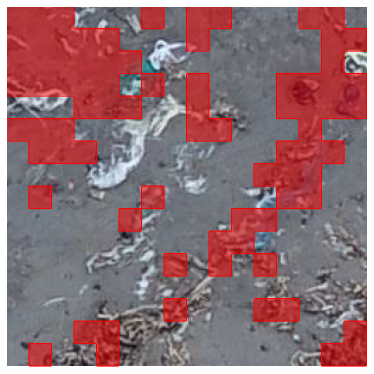

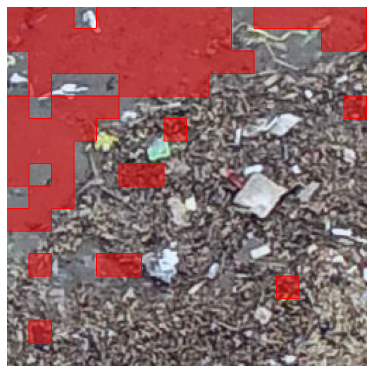

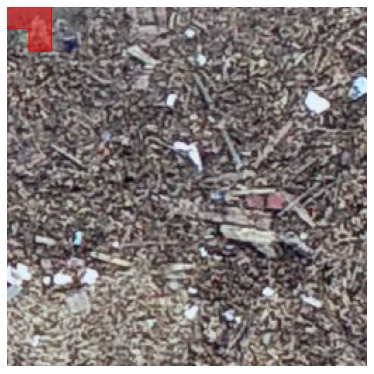

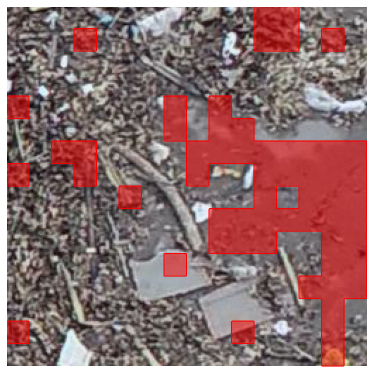

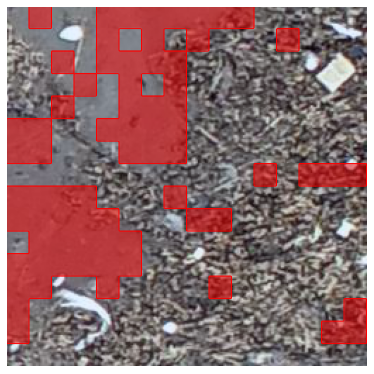

...

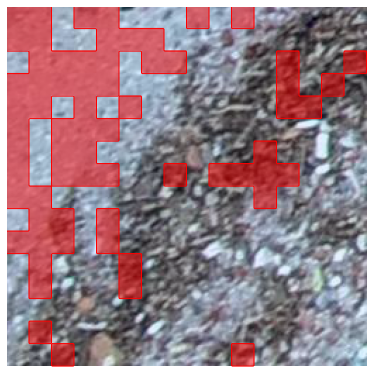

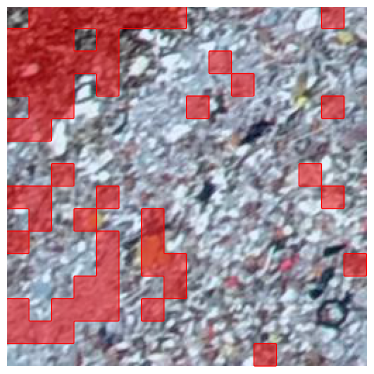

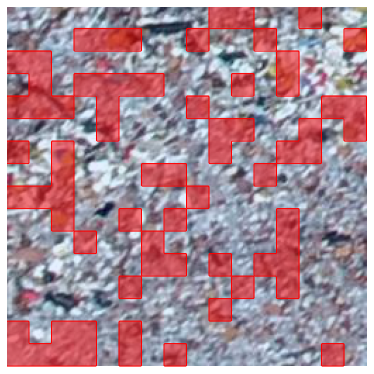

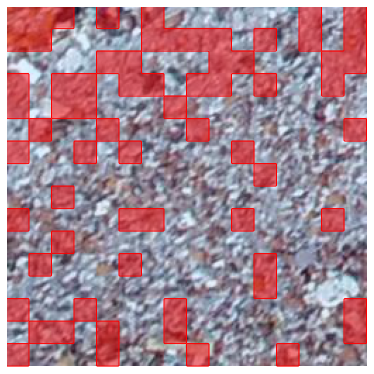

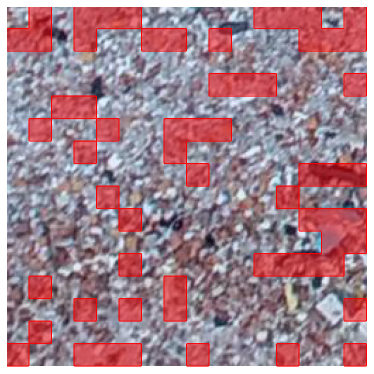

In [ ]:
import glob
patches = glob.glob('/content/drive/MyDrive/predicted_patches/litter/*.JPG')
for p in patches[0:100]:
  d_map['image_path'] = p
  create_attention_maps(d_map) 